$$- \nabla \cdot (a(x, \omega_1) \cdot \nabla u(x)) = f(x) \hspace{0.2cm} \text{on} \hspace{0.2cm} D(\omega_2)$$
where $a(x, \omega_1) = \log(Z(x, \omega_1))$, $Z$ being gaussian  \
and $V(x, \omega_2)$ is the random field corresponding to $D(\omega_2)$

In [22]:
from scipy.interpolate import griddata
import plotly.graph_objects as go

from helpers_diffusion import *
from helpers import *

In [ ]:
MESH_RESOLUTION = 3

SIGMA = 5.0 #! later 1 again 
l = 0.1
def z_cov(x0, x1, y0, y1):
    # Exponential Covariance Function
    return SIGMA**2 * np.exp(-np.sqrt((x0 - y0)**2 + (x1 - y1)**2) / l)

In [24]:
# for MESH_RESOLUTION = 4 it takes approx. 2 minutes

# Calculate the eigenpairs
randomFieldV, jacobianV = calculate_vector_field_eigenpairs(MESH_RESOLUTION)
randomFieldZ = z_calculate_random_field_eigenpairs(MESH_RESOLUTION, z_cov)

In [25]:
print(f"Eigenvalues of z: {randomFieldZ.eigenvalues}")
print(f"Eigenvectors of z: {randomFieldZ.eigenvectors}")

Eigenvalues of z: [6.24927893 5.48679001 5.37049856 4.66762114 4.54476077 4.26142445
 3.98287148 3.77213301 3.61213035 3.54147276 3.22971596 3.06911581
 2.77009398 2.66712649 2.52108675 2.32297869 2.19534521 2.11486018
 1.90021589 1.85994126 1.72268595 1.69379951 1.56546632 1.48340364
 1.44019973 1.34093695 1.33397623 1.19015583 1.149146   1.11744735
 1.11187981 1.01494822]
Eigenvectors of z: [[ 0.28234923  0.00872975 -0.24011835 ... -0.01630652 -0.07403899
  -0.00080873]
 [ 0.12242407 -0.11416402 -0.19172356 ... -0.02767881  0.07710837
   0.0030679 ]
 [ 0.09812172 -0.07231477  0.18447739 ...  0.07668809 -0.02181411
   0.47884165]
 ...
 [ 0.12931072  0.22637608  0.06815502 ...  0.00273489 -0.01820438
   0.00819065]
 [ 0.10191113 -0.18121483  0.10077806 ... -0.4223359   0.160841
  -0.17704974]
 [ 0.10242687 -0.14651408  0.14425761 ...  0.4156914  -0.14929711
   0.28097478]]


In [26]:
# with mesh resolution 32 it takes approx. 2 minutes
len_xi_v = 2

x = fe.Point(0,0)
xi_v = np.random.uniform(-np.sqrt(3), np.sqrt(3), len_xi_v)
xi_z = np.random.normal(0, 1, randomFieldZ.J)

mesh = mshr.generate_mesh(DOMAIN, 32)
V = fe.FunctionSpace(mesh, 'P', 1)
a_hat_function = fe.Function(V)
for i, x in enumerate(mesh.coordinates()):
    a_hat_value = a_hat_random_field(x, randomFieldV, randomFieldZ, xi_v, xi_z)
    a_hat_function.vector()[i] = a_hat_value

    Building point search tree to accelerate distance queries.
    Computed bounding box tree with 63 nodes for 32 points.
    Building point search tree to accelerate distance queries.
    Computed bounding box tree with 63 nodes for 32 points.


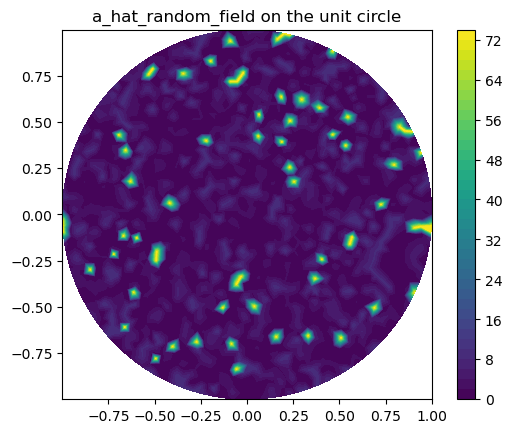

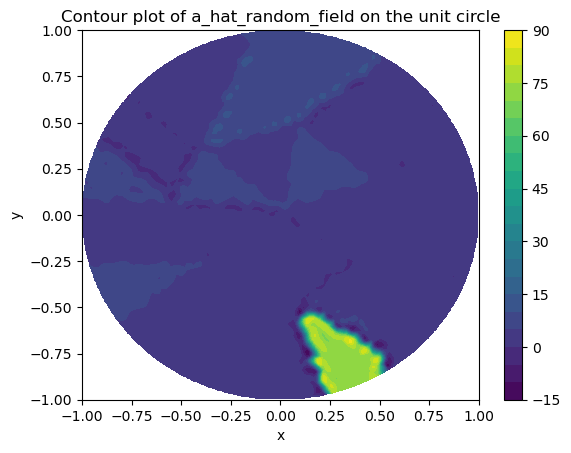

In [27]:
# Plot the function using FEniCS and Matplotlib
plt.figure()
c = fe.plot(a_hat_function)
plt.title('a_hat_random_field on the unit circle')
plt.colorbar(c)
plt.show()


# Create a grid of points for the contour plot
x_coords = mesh.coordinates()[:, 0]
y_coords = mesh.coordinates()[:, 1]
z_values = a_hat_function.vector().get_local()

grid_x, grid_y = np.mgrid[-1:1:500j, -1:1:500j]
grid_z = griddata((x_coords, y_coords), z_values, (grid_x, grid_y), method='cubic')


# Create the contour plot using Matplotlib
plt.figure()
contour = plt.contourf(grid_x, grid_y, grid_z, levels=20, cmap='viridis')
plt.colorbar(contour)
plt.title('Contour plot of a_hat_random_field on the unit circle')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

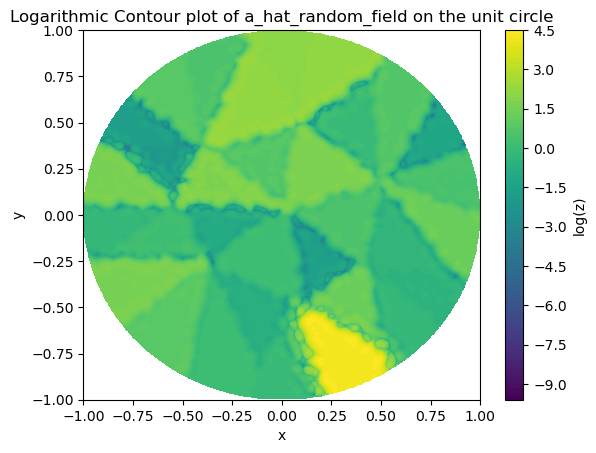

In [28]:
grid_x, grid_y = np.mgrid[-1:1:500j, -1:1:500j]  # Increased resolution
grid_z = griddata((x_coords, y_coords), z_values, (grid_x, grid_y), method='cubic')

# Apply a logarithmic transformation to the z-values
log_grid_z = np.log(np.abs(grid_z) + 1e-10)  # Adding a small value to avoid log(0)

# Create the contour plot using Matplotlib with a logarithmic z-scale
plt.figure()
contour = plt.contourf(grid_x, grid_y, log_grid_z, levels=120, cmap='viridis')
plt.colorbar(contour, label='log(z)')
plt.title('Logarithmic Contour plot of a_hat_random_field on the unit circle')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

In [29]:
mc_sample_sizes = [1, 2, 4]
len_xi_v = 2
len_xi_z = 8
mesh_resolution_NVA = 4
mesh_resolution_inverse_mapping = MESH_RESOLUTION
mesh_resolution_solution = 4


for mc_sample_size in mc_sample_sizes:
    # Maybe consider pushing out some fixed code of the loop, but for refactoring reasons it is kept here

    xis_v = [np.random.uniform(-np.sqrt(3), np.sqrt(3), len_xi_v) for _ in range(mc_sample_size)]
    xis_z = [np.random.normal(0, 1, len_xi_z) for _ in range(mc_sample_size)]

    NVA = non_varying_area(len_xi_v, randomFieldV)
    mesh_NVA = mshr.generate_mesh(NVA, mesh_resolution_NVA)

    V = fe.FunctionSpace(mesh_NVA, 'P', 1)
    dofmap = V.dofmap()
    dof_coordinates = V.tabulate_dof_coordinates().reshape((-1, mesh_NVA.geometry().dim())) # Those are all the point in mesh_NVA but ordered by the dof which we need to assign by the means

    u_P_NVA_mean = np.zeros(len(dof_coordinates))

    u_sols = []
    for xi_v, xi_z in zip(xis_v, xis_z):
        u_sols.append(solve_diffusion_poisson_for_given_sample(mesh_resolution_solution, RHS_F, randomFieldV, jacobianV, randomFieldZ, xi_v, xi_z))
        
    for i, P_coords in enumerate(dof_coordinates):
        P = fe.Point(P_coords) #! loop can be optimized because P_hat is unique for each xi_v
        for xi, u_sol in zip(xis_v, u_sols):
            P_hat = inverse_mapping(P, randomFieldV, xi, mesh_resolution_inverse_mapping)
            u_P_NVA_mean[i] += u_sol(P_hat) / mc_sample_size

    u_mean = fe.Function(V)
    u_mean.set_allow_extrapolation(True)
    u_mean.vector()[:] = u_P_NVA_mean

    # Extract the values of the function at the mesh points
    x_coords = mesh_NVA.coordinates()[:, 0]
    y_coords = mesh_NVA.coordinates()[:, 1]
    z_values = []

    for i in range(len(x_coords)):
        z_values.append(u_mean(x_coords[i], y_coords[i]))

    # Create a finer grid of points for the surface plot
    grid_x, grid_y = np.mgrid[-1:1:500j, -1:1:500j]  # Increased resolution
    grid_z = griddata((x_coords, y_coords), z_values, (grid_x, grid_y), method='cubic')

    # Create the interactive surface plot using Plotly
    fig = go.Figure(data=[go.Surface(z=grid_z, x=grid_x, y=grid_y, colorscale='Viridis')])

    # Customize the plot
    fig.update_layout(title=f'Mean solution Function for {mc_sample_size} samples', autosize=True,
                    scene=dict(xaxis_title='x', yaxis_title='y', zaxis_title='u(x, y)'),
                    margin=dict(l=65, r=50, b=65, t=90))
    fig.show()


R_nv (maximal perturbation distance): 0.5510775527690656
    Solving linear variational problem.


R_nv (maximal perturbation distance): 0.5510775527690656
    Solving linear variational problem.


KeyboardInterrupt: 